# Assignment 3
## Decision Trees and Random Forests for Regression, Part 1

### About this notebook

The general description and instructions as well as questions for the walk through Part 1 of the task (this notebook) are found in the Assignment description in Canvas!


In [3]:
# YOU DON'T HAVE TO RUN THIS IF EVERYTHING IS ALREADY INSTALLED CORRECTLY
!pip3 install --upgrade pip
!pip3 install graphviz
!pip3 install dtreeviz
!pip3 install numpy scipy

## Steps 0-2: Dataset(s)

**Step 0:** First, load the dataset. Ultimately, you should be working with the California housing data, but for quicker test runs, it might help to first start out with the Diabetes data.

In [4]:
from sklearn.datasets import load_diabetes
from sklearn.datasets import fetch_california_housing
from ConceptDataRegr import ConceptDataRegr
from sklearn.model_selection import train_test_split 

import ssl
ssl._create_default_https_context = ssl._create_unverified_context

#test_case = 'diabetes'
test_case = 'california'

if test_case == 'california':
    dataset = fetch_california_housing()
elif test_case == 'diabetes':
    dataset = load_diabetes()
else:
    raise ValueError('Unknown test case')

X = dataset.data
y = dataset.target


**Step 1:** Get some information about the dataset you're looking at

In [5]:
if test_case == 'california' :
    print("target:", list(dataset.target_names))
print("features:", list(dataset.feature_names))
print("description:", dataset.DESCR)


target: ['MedHouseVal']
features: ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude']
description: .. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

:Number of Instances: 20640

:Number of Attributes: 8 numeric, predictive attributes and the target

:Attribute Information:
    - MedInc        median income in block group
    - HouseAge      median house age in block group
    - AveRooms      average number of rooms per household
    - AveBedrms     average number of bedrooms per household
    - Population    block group population
    - AveOccup      average number of household members
    - Latitude      block group latitude
    - Longitude     block group longitude

:Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The target variable is the median house value for Califor

**Step 2:** Split the data into train, validation and test sets.

In [6]:
# splitting using the proper SKLearn tools
train_ratio = 0.70
validation_ratio = 0.15
test_ratio = 0.15
X = dataset.data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=1 - train_ratio, random_state=0)
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=test_ratio/(test_ratio + validation_ratio), random_state=0)

## Step 3: The SKLearn Decision Tree Regressor

Set up and fit a DecisionTreeRegressor with *random_state=0* ([DecisionTreeRegressor](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeRegressor.html?highlight=decision+tree)), use its *score* method to evaluate it in a simple step. Check also out [cross_val_score](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_val_score.html)
to learn about a different type of evaluation tool. Use the documentation where needed. Be prepared to answer "random" questions posed by the TA. 

In [7]:
from sklearn.tree import DecisionTreeRegressor

# set up your first regressor, e.g.: regressor1 = ...
regressor1 = DecisionTreeRegressor(random_state=0)
regressor1.fit(X_train, y_train)
print("validation score:", regressor1.score(X_val, y_val))


validation score: 0.5913806202834724


In [8]:
from sklearn.model_selection import cross_val_score
# apply cross_val_score on your regressor1 (obs, this is done on training data) and see what happens
# go for cv=10 for a start, but you can also test different values
cv_scores = cross_val_score(regressor1 , X_train, y_train, cv=10)
print("10-fold CV:", cv_scores)
print("mean 10-fold CV:", cv_scores.mean())

10-fold CV: [0.58069651 0.63561316 0.59517376 0.6015455  0.58837564 0.60948464
 0.59118007 0.56681236 0.52772062 0.67589022]
mean 10-fold CV: 0.5972492479953516


In [9]:
# fit your regressor1 to training data and evaluate with 'score' on the test data
test_score = regressor1.score(X_test, y_test)
print("Test R²:", test_score)


Test R²: 0.60266533900018


## Step 4: Decision Tree Parameters
Now, work with two parameters, *max_depth* and *min_samples_leaf*. Analyse the documentation to understand what they do. Create two more regressors, where you experiment with different settings for those parameters, e.g. 1 for *max_depth* and 20 for *min_samples_leaf*. Evaluate with both *cross_val_score* and *score*.
Explain the outcomes.

In [10]:
# regressor2...
regressor2 = DecisionTreeRegressor(max_depth=1, random_state=0)
regressor2.fit(X_train, y_train)

print("\nModel 2 (max_depth=1)")
print("Test score:", regressor2.score(X_test, y_test))
print("CV scores:", cross_val_score(regressor2, X_train, y_train, cv=10))
print("CV mean:", cross_val_score(regressor2, X_train, y_train, cv=10).mean())



Model 2 (max_depth=1)
Test score: 0.2958635051924463
CV scores: [0.3093173  0.31084997 0.3238698  0.26062284 0.34982138 0.28834936
 0.31131296 0.32220031 0.26295319 0.36589174]
CV mean: 0.3105188838001503


In [11]:
# regressor3 ...
regressor3 = DecisionTreeRegressor(min_samples_leaf=20, random_state=0)
regressor3.fit(X_train, y_train)

print("\nModel 3 (min_samples_leaf=20)")
print("Test score:", regressor3.score(X_test, y_test))
print("CV scores:", cross_val_score(regressor3, X_train, y_train, cv=10))
print("CV mean:", cross_val_score(regressor3, X_train, y_train, cv=10).mean())



Model 3 (min_samples_leaf=20)
Test score: 0.7159977936230865
CV scores: [0.70559734 0.7130729  0.73822167 0.70004541 0.73592394 0.72537751
 0.70869509 0.70540392 0.69394141 0.74850674]
CV mean: 0.7174785915545112


In [12]:
# for part 2 form
regressor4 = DecisionTreeRegressor(max_depth=1,min_samples_leaf=20, random_state=0)
regressor4.fit(X_train, y_train)

print("\nModel 4 ")
print("Test R² score:", regressor4.score(X_test, y_test))
print("CV scores:", cross_val_score(regressor4, X_train, y_train, cv=10))
print("CV mean:", cross_val_score(regressor4, X_train, y_train, cv=10).mean())



Model 4 
Test R² score: 0.2958635051924463
CV scores: [0.3093173  0.31084997 0.3238698  0.26062284 0.34982138 0.28834936
 0.31131296 0.32220031 0.26295319 0.36589174]
CV mean: 0.3105188838001503


## Steps 5-6: Decision Tree Visualization

The next cells give examples how to visualize regressor2 and regressor3.

**Step 5:** Visualisation with GraphViz, which was used for the lecture slides, but with rectangular nodes

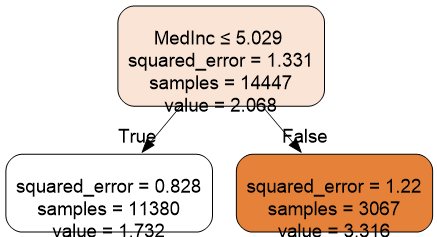

In [13]:
from sklearn import tree
import graphviz
from IPython.display import Image

# The visualisation below assumes a regressor called 'regressor2'. 
# Change in the code below if your naming above is different

dot_data = tree.export_graphviz(regressor2, feature_names=dataset.feature_names, out_file=None, filled=True, rounded=True, special_characters=True)
graph = graphviz.Source(dot_data, format="png") 
graph.render("decision_tree_regressor2")
Image("decision_tree_regressor2.png")

s5 minimizes MSE to the greatest extent possible
Value:Disease progression value


In [14]:
# The visualisation below assumes a regressor called 'regressor3'. 
# Change in the code below if your naming above is different

dot_data = tree.export_graphviz(regressor3, feature_names=dataset.feature_names, out_file=None, filled=True, rounded=True, special_characters=True)
graph = graphviz.Source(dot_data, format="png") 
graph.render("decision_tree_regressor3")
Image("decision_tree_regressor3.png")

Whether each node continues to split depends on whether the local data can successfully reduce the MSE.
Decision trees allow a feature to be used multiple times at different nodes and depths.
s3 ≤ 0.021
│
├── LEFT: s5 ≤ -0.043  (90)
└── RIGHT: s5 > -0.043 
    │
    └── s5 ≤ -0.034 (67)

**Step 6:** Another way to visualize the decision trees is to use dtreeviz. To make these plots it takes quite some time, so we recommend to use this visualization tool for trees with few nodes only. 

In [15]:
import dtreeviz

# The visualisation below assumes a regressor called 'regressor2'. 
# Change in the code below if your naming above is different

viz = dtreeviz.model(regressor2, X, y,
                target_name="target",
                feature_names=dataset.feature_names)

viz.view(fontname="monospace", scale=3) # this displays the output inside the notebook.


# If you want to store the output in a file use:
#viz.save("dtreeviz.svg")


## Steps 7-9: Explainability

**Step 7:** If you want to visualize (explain) the decision path for one prediction, you can also use dtreeviz:

In [16]:
import numpy as np

# The visualisation below assumes a regressor called 'regressor2'. 
# Change in the code below if your naming above is different

sample = X_test[np.random.randint(0, len(X_test)),:] # random sample from training

viz = dtreeviz.model(regressor2, X, y,
                target_name="target",
                feature_names=dataset.feature_names)

viz.view(fontname="monospace", scale=2, x = sample)

**Step 8:** For bigger graphs you just show the decision path

In [17]:
# The visualisation below assumes a regressor called 'regressor3'. 
# Change in the code below if your naming above is different

viz = dtreeviz.model(regressor3, X, y,
                target_name="target",
                feature_names=dataset.feature_names)
#viz.view()
viz.view(fontname="monospace", scale=3, x=sample, show_just_path=True)

**Step 9:** Another option to explain the prediction for big trees is this

In [18]:


# The call below assumes a regressor called 'regressor3'. 
# Change in the code below if your naming above is different

print(viz.explain_prediction_path(sample))

3.68 <= MedInc  < 5.03
HouseAge < 21.5
AveOccup < 2.34
34.17 <= Latitude  < 37.94
Longitude < -118.26



means that the model first checks the BMI feature, then the BP feature, and finally s5.

## Step 10: Random Forests

Create a *RandomForestRegressor*, e.g. for 5 or 10 trees, and experiment with different parameters for it (explore the documentation!). Test at least two different parameter sets (evaluate with *score*) and discuss the outcomes.

In [21]:
from sklearn.ensemble import RandomForestRegressor

# number_of_trees = ... 
# forest = ...
from sklearn.metrics import r2_score

forest1 = RandomForestRegressor(
    n_estimators=8,     # 5 trees
    random_state=0
)
forest1.fit(X_train, y_train)
score1 = forest1.score(X_test, y_test)
print("Model 1 Test Score:", score1)

# min_samples_leaf
forest2 = RandomForestRegressor(
    n_estimators=5,     # more trees
    max_depth=None,      # allow deeper trees
    min_samples_leaf=5,  # slightly smoother leaves
    random_state=0
)
forest2.fit(X_train, y_train)
score2 = forest2.score(X_test, y_test)
print("Model 2 Test Score:", score2)

#max_depth
forest3 = RandomForestRegressor(
    n_estimators=5,     # more trees
    max_depth=1,      # allow deeper trees
    #min_samples_leaf=5,  # slightly smoother leaves
    random_state=0
)
forest3.fit(X_train, y_train)
score3 = forest3.score(X_test, y_test)
print("Model 3 Test Score:", score3)

#n_estimators
forest4 = RandomForestRegressor(
    n_estimators=10,     # 10 trees
    random_state=0
)
forest4.fit(X_train, y_train)
score4 = forest4.score(X_test, y_test)
print("Model 1 Test Score:", score4)

forest5 = RandomForestRegressor(
    n_estimators=10,     # 10 trees
    max_depth=8,      # allow deeper trees
    min_samples_leaf=5,  # slightly smoother leaves
    random_state=0
)
forest5.fit(X_train, y_train)
score5 = forest5.score(X_test, y_test)
print("Model 5 Test Score:", score5)


Model 1 Test Score: 0.7746310912580946
Model 2 Test Score: 0.775710638445561
Model 3 Test Score: 0.31871879659013813
Model 1 Test Score: 0.7818928192073125
Model 5 Test Score: 0.7434244264521308


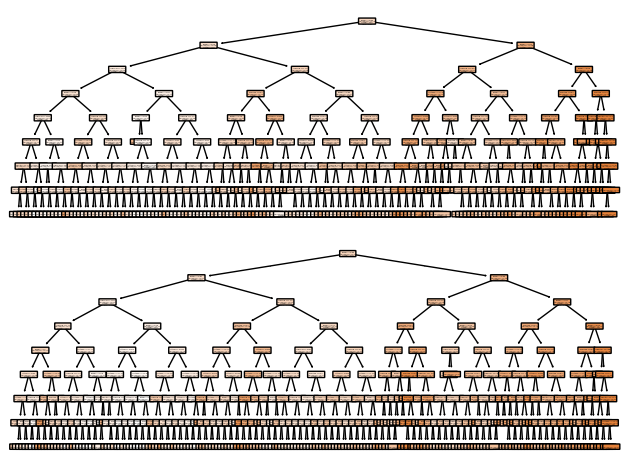

In [20]:
# You can visualise the trees as above - but maybe not more than 5 and not the really big ones ;-)

# The visualisation below assumes a random forest called 'forest' and a parameter 'number_of_trees'. 
# Change in the code below if your naming above is different
import matplotlib.pyplot as plt
from sklearn import tree
forest = RandomForestRegressor(n_estimators=2, max_depth=8, min_samples_leaf=5,random_state=0)
forest.fit(X_train, y_train)
number_of_trees = forest.n_estimators

for treeid in range(number_of_trees):
    dot_data = tree.export_graphviz(forest.estimators_[treeid], feature_names=dataset.feature_names, out_file=None, filled=True, rounded=True, special_characters=True)
    #graph = graphviz.Source(dot_data, format="png") 
    #graph.render("forest_treeid"+str(treeid))

fig, ax = plt.subplots(number_of_trees,1) # use plt.subplots(number_of_trees/2,2) if you want two columns
for i, axi in enumerate(ax.flat):
    axi.set_title("Tree {}".format(i))
    tree.plot_tree(forest.estimators_[i], ax=axi, feature_names=dataset.feature_names, filled=True, rounded=True)
fig.tight_layout()